In [1]:
!pip install pycocotools

In [2]:
import augmentation, os, torch, torchvision
import matplotlib.pyplot as plt

from PIL import Image
from pycocotools.coco import COCO
from torch.utils.data import Dataset

# Ignore Warning
import warnings
warnings.filterwarnings(action='ignore')

In [3]:
class COCO_detection(Dataset):
    def __init__(self, img_dir, ann, transforms=None):
        super(COCO_detection, self).__init__()
        self.img_dir = img_dir
        self.transforms = transforms
        self.coco = COCO(ann)
        self.ids = list(sorted(self.coco.imgs.keys()))
        self.label_map = {raw_label:i for i, raw_label in enumerate(self.coco.getCatIds())}

    def _load_image(self, id_):
        img = self.coco.loadImgs(id_)[0]['file_name']
        return Image.open(os.path.join(self.img_dir, img)).convert('RGB')

    def _load_target(self, id_):
        if len(self.coco.loadAnns(self.coco.getAnnIds(id_))) == 0: return None, None
        bboxs, labels = [], []
        for ann in self.coco.loadAnns(self.coco.getAnnIds(id_)):
            min_x, min_y, w, h = ann['bbox']
            bboxs.append(torch.FloatTensor([min_x, min_y, min_x+w, min_y+h]))
            labels.append(self.label_map[ann['category_id']])
        bboxs, labels = torch.stack(bboxs, 0), torch.LongTensor(labels)
        return bboxs, labels

    def __getitem__(self, index):
        id_ = self.ids[index]
        image, (bboxs, labels) = self._load_image(id_), self._load_target(id_)
        if self.transforms is not None:
            image, bboxs = self.transforms(image, bboxs)

        return image, bboxs, labels

    def __len__(self):
        return len(self.ids)

In [4]:
train_image_dir = '../../../../data/OCR/Jason/COCO/images/train2017/'
train_ann = '../../../../data/OCR/Jason/COCO/annotations/instances_train2017.json'

dataset = COCO_detection(train_image_dir, train_ann)

loading annotations into memory...
Done (t=76.88s)
creating index...
index created!


In [5]:
ex1, ex2, ex3, ex4 = dataset[2], dataset[25], dataset[28], dataset[42]

In [6]:
M = 30

color_range = torch.arange(0, 0.9+1e-8, (0.9-0)/M).tolist()
rotate_range = torch.arange(0, 30+1e-8, (30-0)/M).tolist()
shear_range = torch.arange(0, 0.3+1e-8, (0.3-0)/M).tolist()
translate_range = torch.arange(0, 10+1e-8, (10-0)/M).tolist()


Mag = {'Brightness' : color_range, 'Color' : color_range, 'Contrast' : color_range, 
       'Posterize' : torch.arange(4, 8+1e-8, (8-4)/M).tolist()[::-1], 'Sharpness' : color_range, 
       'Solarize' : torch.arange(0, 256+1e-8, (256-0)/M).tolist()[::-1], 
       'SolarizeAdd' : torch.arange(0, 110+1e-8, (110-0)/M).tolist(), 
       
       'Cutout' : torch.arange(0, 32*0.15+1e-8, (32*0.15-0)/M),
       
       'Rotate' : rotate_range, 'ShearX' : shear_range, 'ShearY' : shear_range,
       'TranslateX' : translate_range, 'TranslateY' : translate_range}


Fun = {'Brightness' : augmentation.Brightness, 
       'Color' : augmentation.Color, 'Contrast' : augmentation.Contrast,  
       'Posterize' : augmentation.Posterize, 'Sharpness' : augmentation.Sharpness, 
       'Solarize' : augmentation.Solarize, 'SolarizeAdd' : augmentation.SolarizeAdd,
       
       'Cutout' : augmentation.Cutout,
         
       'Rotate' : augmentation.Rotate, 'ShearX' : augmentation.ShearX, 'ShearY' : augmentation.ShearY, 
       'TranslateX' : augmentation.TranslateX, 'TranslateY' : augmentation.TranslateY}

In [7]:
aug_list, title_list = [], []
M = [10, 20]

for f in Fun:
    if f in ['Cutout', 'Posterize', 'Solarize']: aug_list.append([Fun[f](1, Mag[f][M[0]]), Fun[f](1, Mag[f][M[1]])])
    else: aug_list.append([Fun[f](1, Mag[f][M[0]], minus=False), Fun[f](1, Mag[f][M[1]], minus=False)])
    title_list.append(['Function : {}, Magnitude : {}'.format(f, M[0]), 'Function : {}, Magnitude : {}'.format(f, M[1])])

In [8]:
for a, t in zip(aug_list, title_list):
    print(a)
    print(t)
    print()

[Brightness(p=1, magnitude=0.29999998211860657), Brightness(p=1, magnitude=0.6000000238418579)]
['Function : Brightness, Magnitude : 10', 'Function : Brightness, Magnitude : 20']

[Color(p=1, magnitude=0.29999998211860657), Color(p=1, magnitude=0.6000000238418579)]
['Function : Color, Magnitude : 10', 'Function : Color, Magnitude : 20']

[Contrast(p=1, magnitude=0.29999998211860657), Contrast(p=1, magnitude=0.6000000238418579)]
['Function : Contrast, Magnitude : 10', 'Function : Contrast, Magnitude : 20']

[Posterize(p=1, bits=6), Posterize(p=1, bits=5)]
['Function : Posterize, Magnitude : 10', 'Function : Posterize, Magnitude : 20']

[Sharpness(p=1, magnitude=0.29999998211860657), Sharpness(p=1, magnitude=0.6000000238418579)]
['Function : Sharpness, Magnitude : 10', 'Function : Sharpness, Magnitude : 20']

[Solarize(p=1, threshold=170), Solarize(p=1, threshold=85)]
['Function : Solarize, Magnitude : 10', 'Function : Solarize, Magnitude : 20']

[SolarizeAdd(p=1, addition=36, threshold=

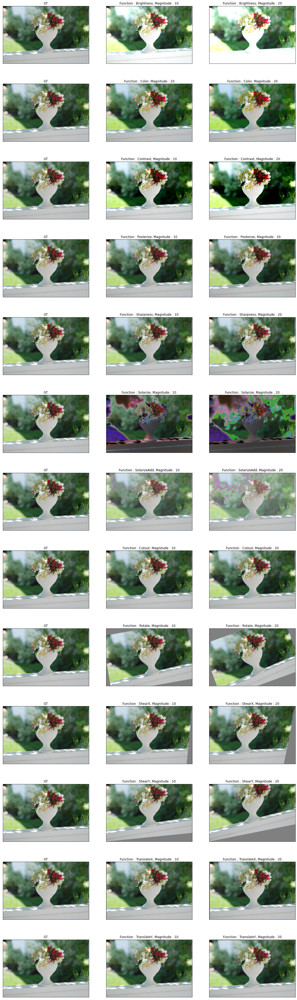

In [9]:
plt.figure(figsize=(20, 70))
plt.rcParams['axes.titlesize'] = 12
plt.axis('off')

for i in range(len(aug_list)):
    plt.subplot(13, 3, 3*i+1)
    image, _, label = ex1
    img = plt.imshow(image); img.axes.get_xaxis().set_visible(False); img.axes.get_yaxis().set_visible(False)
    plt.gca().set_title('GT')
    
    for j in range(len(aug_list[i])):
        plt.subplot(13, 3, 3*i + j + 2)
        aug_image = aug_list[i][j](image)
        aug_image = plt.imshow(aug_image)
        aug_image.axes.get_xaxis().set_visible(False); aug_image.axes.get_yaxis().set_visible(False)
        plt.gca().set_title(title_list[i][j])

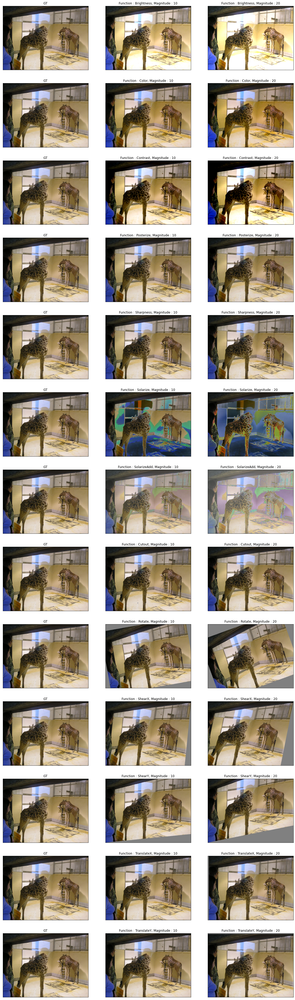

In [10]:
plt.figure(figsize=(20, 70))
plt.rcParams['axes.titlesize'] = 12
plt.axis('off')

for i in range(len(aug_list)):
    plt.subplot(13, 3, 3*i+1)
    image, _, label = ex2
    img = plt.imshow(image); img.axes.get_xaxis().set_visible(False); img.axes.get_yaxis().set_visible(False)
    plt.gca().set_title('GT')

    for j in range(len(aug_list[i])):
        plt.subplot(13, 3, 3*i + j + 2)
        aug_image = aug_list[i][j](image)
        aug_image = plt.imshow(aug_image)
        aug_image.axes.get_xaxis().set_visible(False); aug_image.axes.get_yaxis().set_visible(False)
        plt.gca().set_title(title_list[i][j])

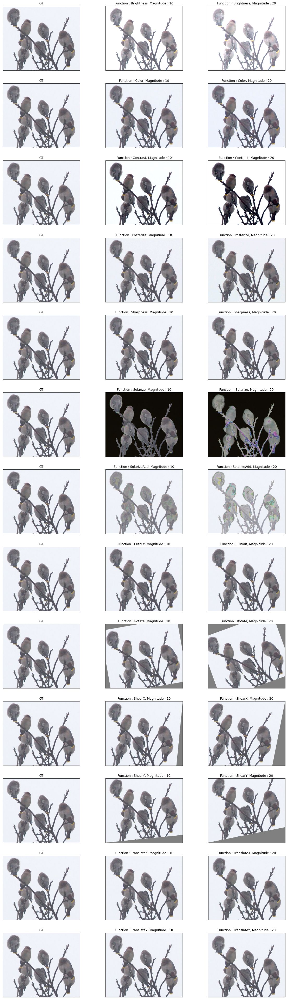

In [11]:
plt.figure(figsize=(20, 70))
plt.rcParams['axes.titlesize'] = 12
plt.axis('off')

for i in range(len(aug_list)):
    plt.subplot(13, 3, 3*i+1)
    image, _, label = ex3
    img = plt.imshow(image); img.axes.get_xaxis().set_visible(False); img.axes.get_yaxis().set_visible(False)
    plt.gca().set_title('GT')

    for j in range(len(aug_list[i])):
        plt.subplot(13, 3, 3*i + j + 2)
        aug_image = aug_list[i][j](image)
        aug_image = plt.imshow(aug_image)
        aug_image.axes.get_xaxis().set_visible(False); aug_image.axes.get_yaxis().set_visible(False)
        plt.gca().set_title(title_list[i][j])

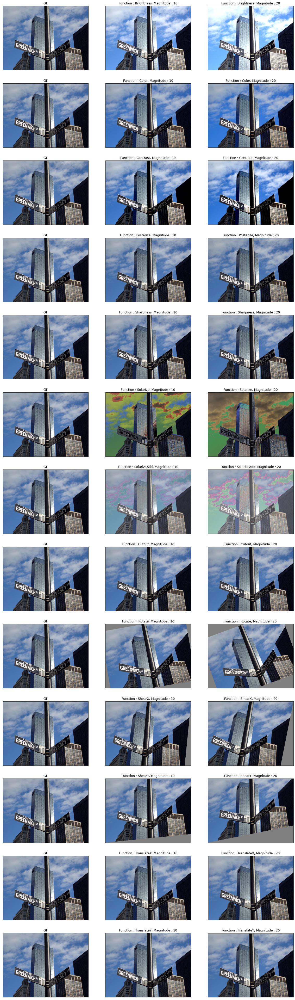

In [12]:
plt.figure(figsize=(20, 70))
plt.rcParams['axes.titlesize'] = 12
plt.axis('off')

for i in range(len(aug_list)):
    plt.subplot(13, 3, 3*i+1)
    image, _, label = ex4
    img = plt.imshow(image); img.axes.get_xaxis().set_visible(False); img.axes.get_yaxis().set_visible(False)
    plt.gca().set_title('GT')
    
    for j in range(len(aug_list[i])):
        plt.subplot(13, 3, 3*i + j + 2)
        aug_image = aug_list[i][j](image)
        aug_image = plt.imshow(aug_image)
        aug_image.axes.get_xaxis().set_visible(False); aug_image.axes.get_yaxis().set_visible(False)
        plt.gca().set_title(title_list[i][j])